In [14]:
%load_ext autoreload
%autoreload 2 
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [4]:
import matplotlib.pyplot as plt
plt.style.use('ggplot')
import os
import pandas as pd
import numpy as np 
import pickle as pk
import glob
from fbprophet import Prophet
import sys
sys.path.append('../')
import wiki
from wiki import utils 
import multiprocessing as mp
total_proc = None
from tqdm import tqdm
from IPython.display import clear_output

# Results Analysis
* majority of bad are due to trend below zero for val period, which makes it predict all zero
* good ones are GOOD!
* outliers should help without hurting too much

In [5]:
PROPHET_PATH = '../data/prophet/'
RESULTS_PATH = 'results/'
VERSION = 'v1.6/'

In [6]:
df = pd.read_feather(PROPHET_PATH+RESULTS_PATH+VERSION[:-1]+'df.f')
page_index = pd.read_feather(PROPHET_PATH+'page_index.f')

In [5]:
df['v1.6_val'].mean()

81.994184568220561

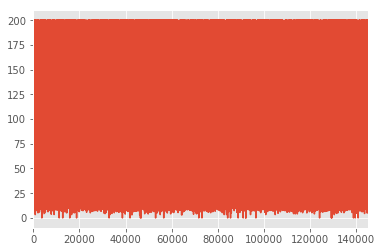

In [6]:
df['v1.6_val'].plot()

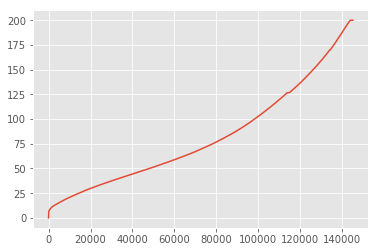

In [7]:
plt.plot((df['v1.6_val'].sort_values().values))

In [9]:
df.head()

,page_index,v1.6_full,v1.6_val
0,52878,94.617728,134.858549
1,130410,89.427607,82.863362
2,9301,175.616946,152.922811
3,41478,86.324262,198.036510
4,2742,79.602258,117.008348


In [14]:
def load_plot(page):
    forecast = pd.read_feather(PROPHET_PATH+VERSION+page+'df.f')
    wiki.newphet.prophet_plot(forecast)

page_index 29930
v1.6_val 200.0
page_index 72654
v1.6_val 200.0
page_index 53413
v1.6_val 200.0
page_index 19468
v1.6_val 200.0
page_index 108103
v1.6_val 200.0
page_index 4881
v1.6_val 200.0
page_index 73062
v1.6_val 200.0
page_index 6069
v1.6_val 200.0
page_index 11217
v1.6_val 200.0
page_index 4691
v1.6_val 200.0
page_index 108296
v1.6_val 200.0
page_index 21311
v1.6_val 200.0
page_index 14969
v1.6_val 200.0
page_index 9506
v1.6_val 200.0
page_index 23399
v1.6_val 200.0
page_index 43154
v1.6_val 200.0
page_index 100797
v1.6_val 200.0
page_index 72540
v1.6_val 200.0
page_index 97731
v1.6_val 200.0
page_index 78335
v1.6_val 200.0
page_index 120256
v1.6_val 200.0
page_index 13123
v1.6_val 200.0
page_index 62593
v1.6_val 200.0


/home/ubuntu/miniconda3/envs/basev1/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


page_index 57587
v1.6_val 200.0
page_index 34769
v1.6_val 200.0
page_index 28572
v1.6_val 200.0
page_index 137708
v1.6_val 200.0
page_index 67964
v1.6_val 200.0
page_index 55654
v1.6_val 200.0
page_index 106200
v1.6_val 200.0
page_index 59744
v1.6_val 200.0
page_index 77877
v1.6_val 200.0
page_index 36021
v1.6_val 200.0
page_index 45095
v1.6_val 200.0
page_index 73241
v1.6_val 200.0
page_index 12218
v1.6_val 200.0
page_index 141036
v1.6_val 200.0
page_index 81472
v1.6_val 200.0
page_index 55860
v1.6_val 200.0
page_index 91685
v1.6_val 200.0
page_index 121715
v1.6_val 200.0
page_index 63576
v1.6_val 200.0
page_index 25546
v1.6_val 200.0
page_index 101932
v1.6_val 200.0
page_index 31098
v1.6_val 200.0
page_index 137489
v1.6_val 200.0
page_index 85823
v1.6_val 200.0
page_index 107651
v1.6_val 200.0
page_index 95349
v1.6_val 200.0
page_index 56634
v1.6_val 200.0
page_index 40918
v1.6_val 200.0
page_index 93621
v1.6_val 200.0
page_index 37080
v1.6_val 200.0
page_index 43265
v1.6_val 200.0
p

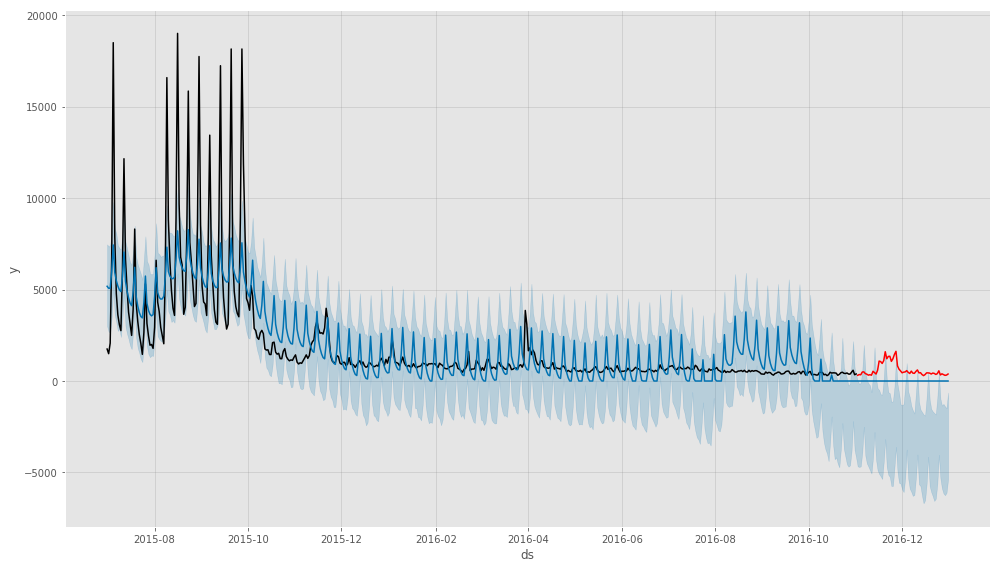

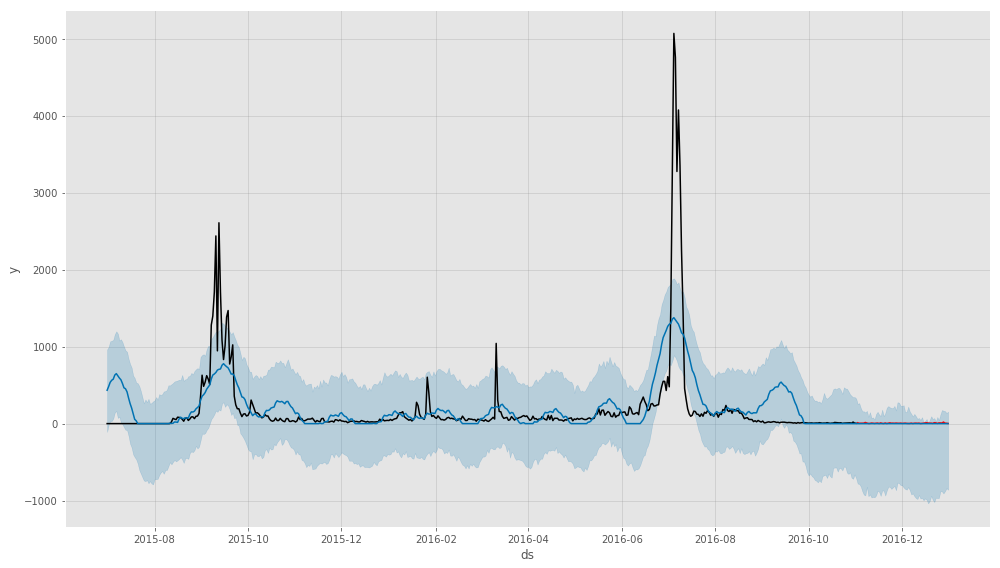

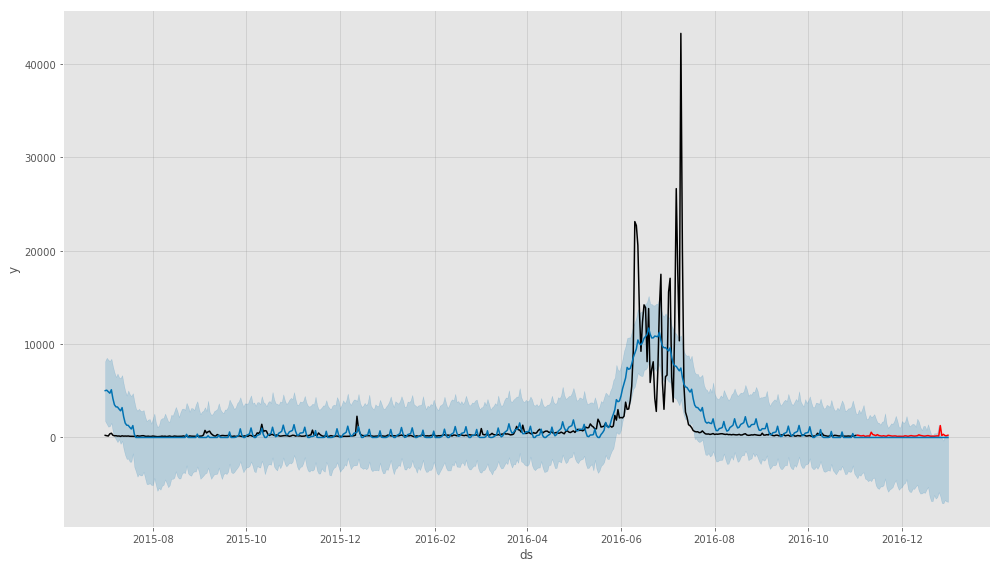

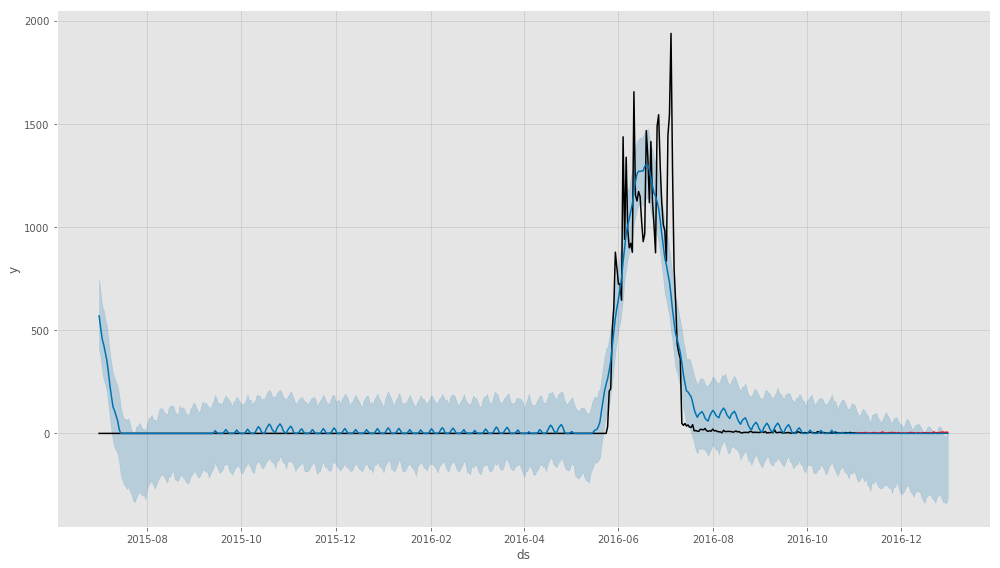

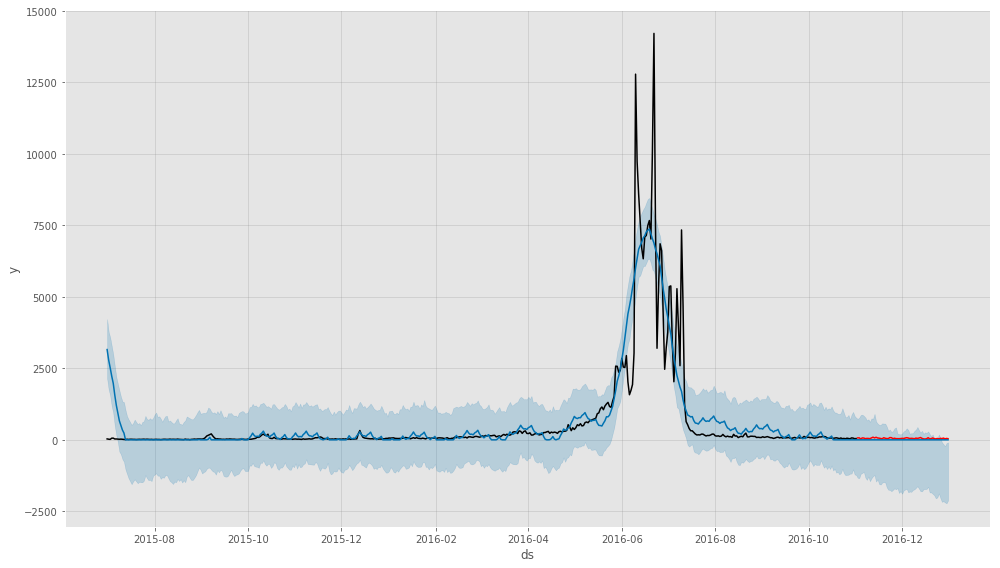

...

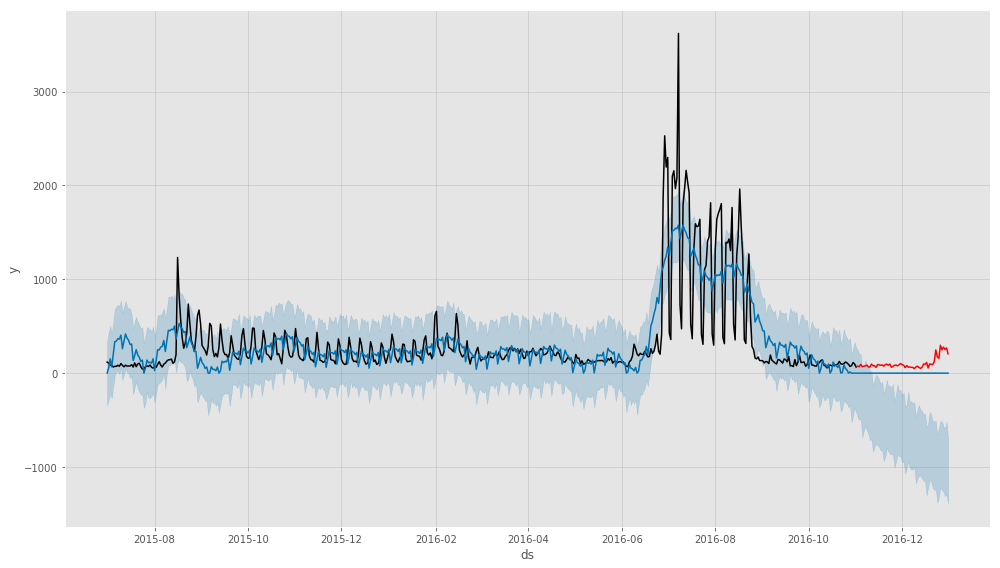

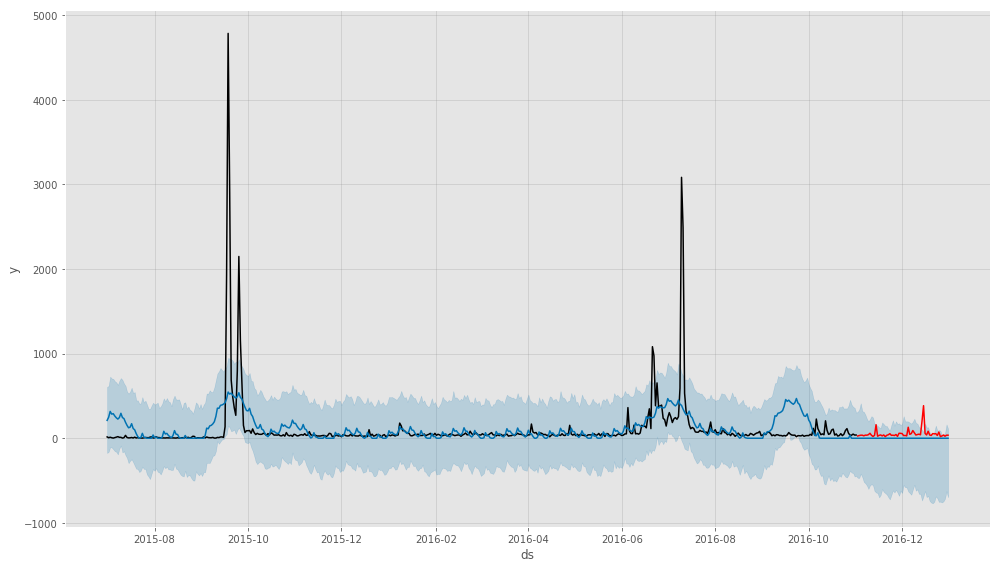

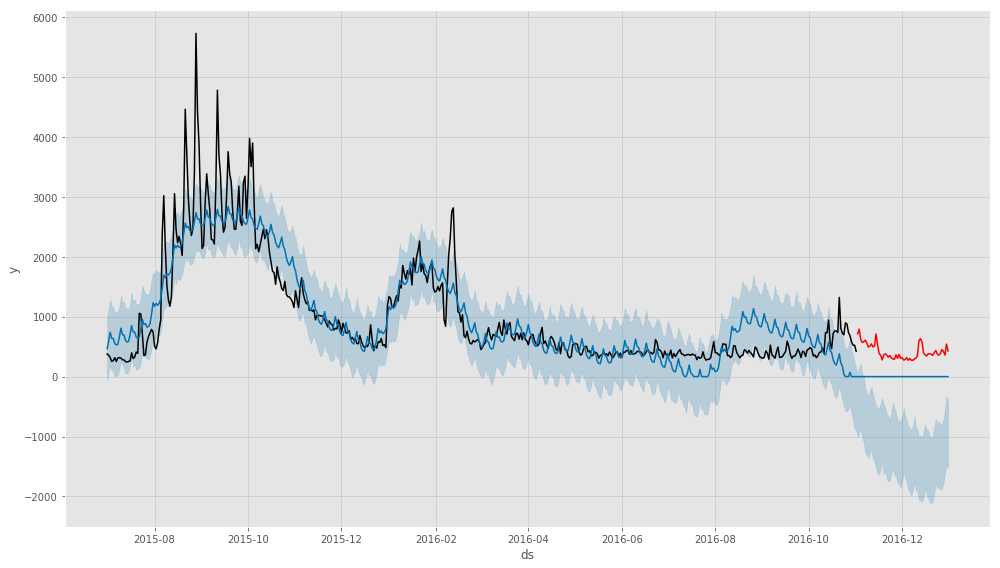

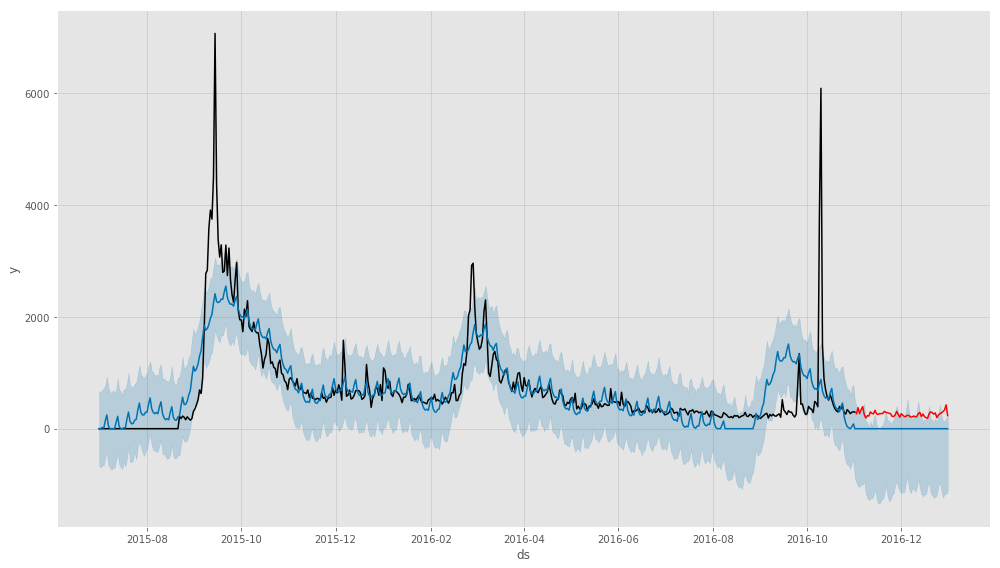

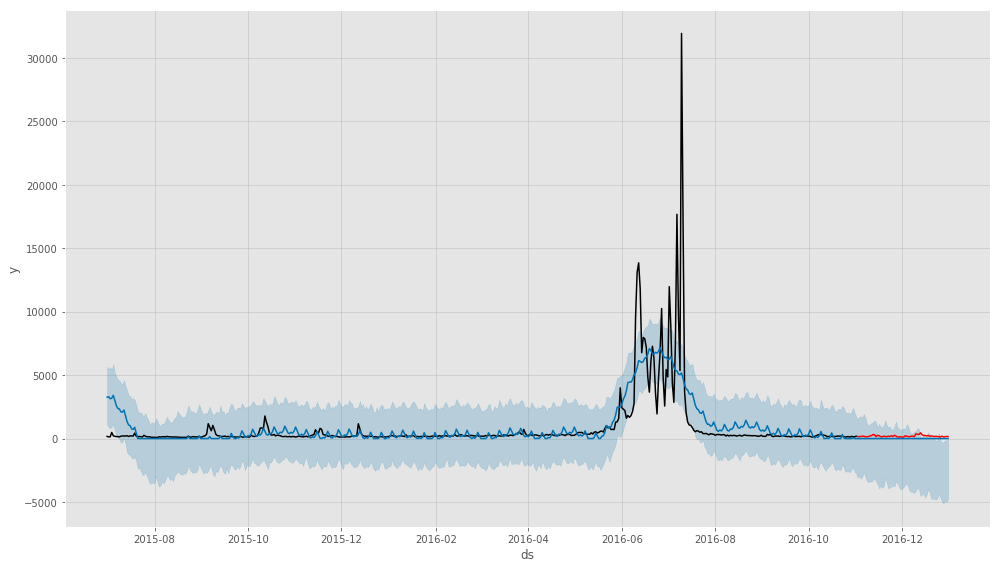

In [15]:
for row in df.sort_values(by='v1.6_val',ascending=False).iloc[:100].iterrows():
    print('page_index', row[1][0])
    print('v1.6_val', row[1][2])
    load_plot(row[1][0])

page_index 20424
v1.6_val 0.0
page_index 89982
v1.6_val 0.0
page_index 89977
v1.6_val 0.0
page_index 20388
v1.6_val 0.0
page_index 20386
v1.6_val 0.0
page_index 89966
v1.6_val 0.0
page_index 143183
v1.6_val 0.0
page_index 32028
v1.6_val 0.0
page_index 20394
v1.6_val 0.0
page_index 89974
v1.6_val 0.0
page_index 81645
v1.6_val 0.0
page_index 5212
v1.6_val 0.0
page_index 78830
v1.6_val 0.0
page_index 45692
v1.6_val 0.0
page_index 64588
v1.6_val 0.0
page_index 4063
v1.6_val 0.0
page_index 108390
v1.6_val 0.0
page_index 24468
v1.6_val 0.0
page_index 19647
v1.6_val 0.0
page_index 89983
v1.6_val 0.0
page_index 89975
v1.6_val 0.0


/home/ubuntu/miniconda3/envs/basev1/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


page_index 20389
v1.6_val 0.0
page_index 127965
v1.6_val 0.0
page_index 109206
v1.6_val 0.0
page_index 14598
v1.6_val 0.0
page_index 21241
v1.6_val 0.0
page_index 20444
v1.6_val 0.0
page_index 116196
v1.6_val 2.871856800332831
page_index 73641
v1.6_val 2.968596779786899
page_index 55104
v1.6_val 3.0305607229276506
page_index 17670
v1.6_val 3.267804972362435
page_index 14680
v1.6_val 3.3333333333333335
page_index 14597
v1.6_val 3.3333333333333335
page_index 89968
v1.6_val 3.3333333333333335
page_index 89973
v1.6_val 3.3333333333333335
page_index 89967
v1.6_val 3.3333333333333335
page_index 89964
v1.6_val 3.3333333333333335
page_index 15719
v1.6_val 3.3333333333333335
page_index 23231
v1.6_val 3.3333333333333335
page_index 89970
v1.6_val 3.3333333333333335
page_index 22270
v1.6_val 3.3333333333333335
page_index 49199
v1.6_val 3.3333333333333335
page_index 7363
v1.6_val 3.4369456631187227
page_index 7594
v1.6_val 3.7007850485688802
page_index 24134
v1.6_val 3.7601101524062788
page_index 5

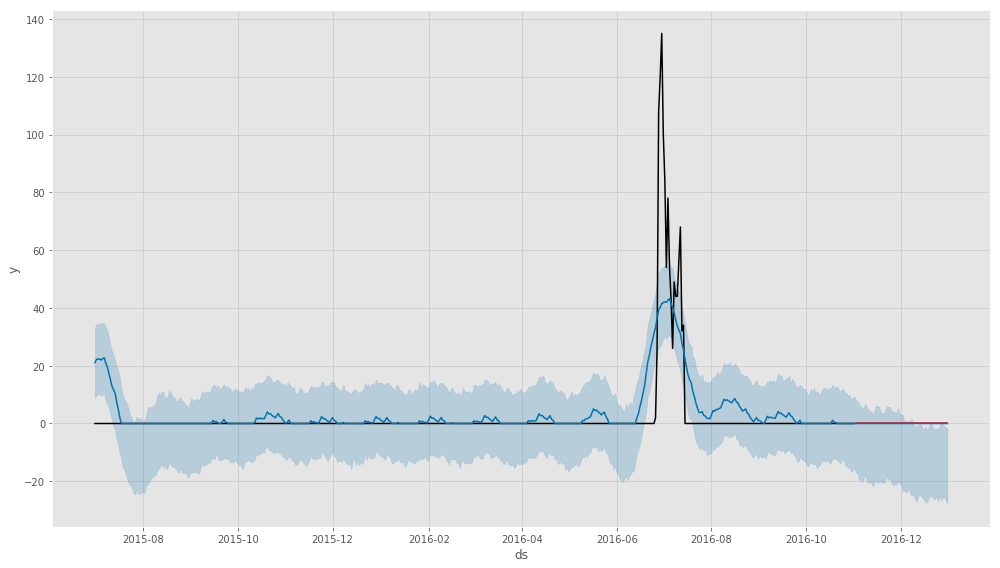

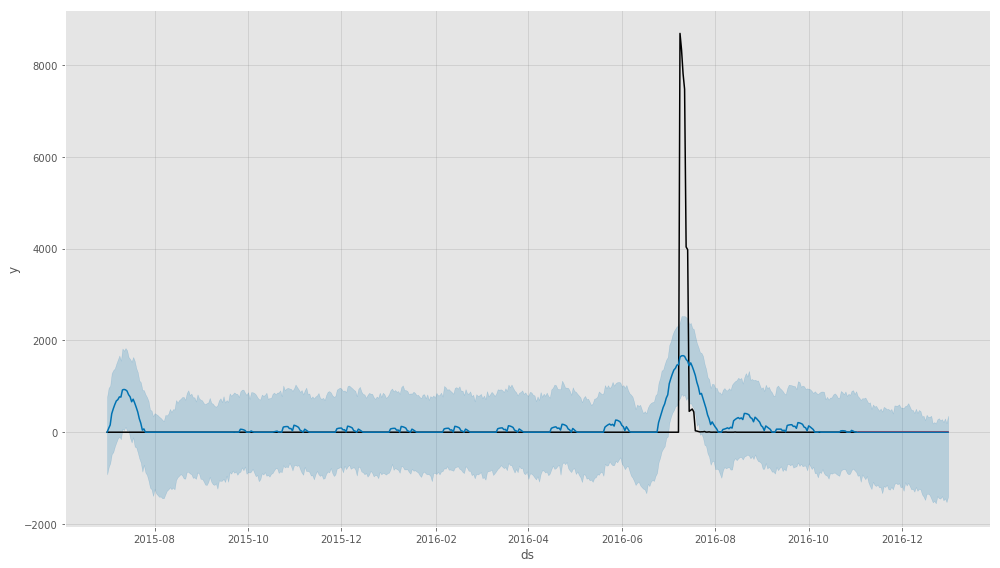

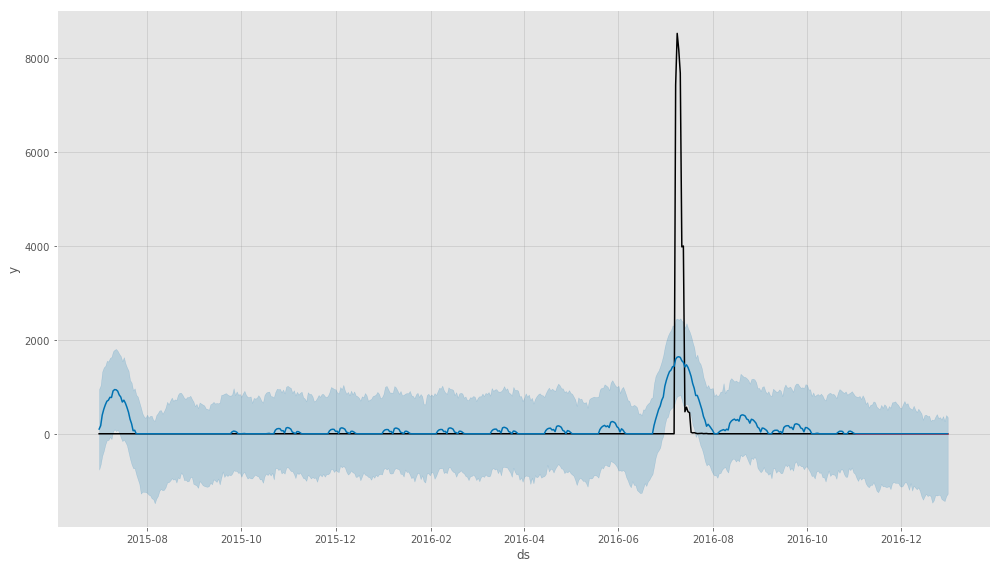

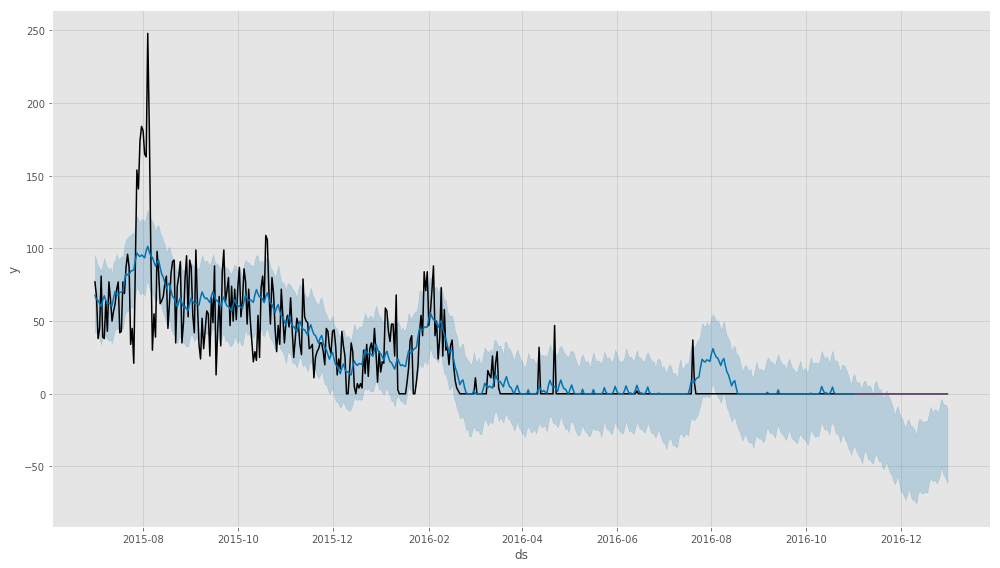

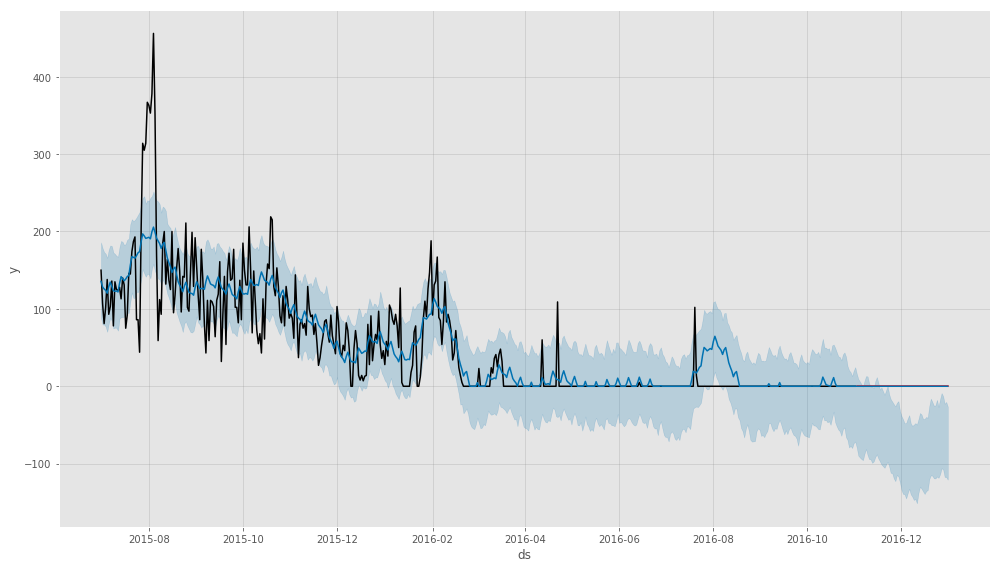

...

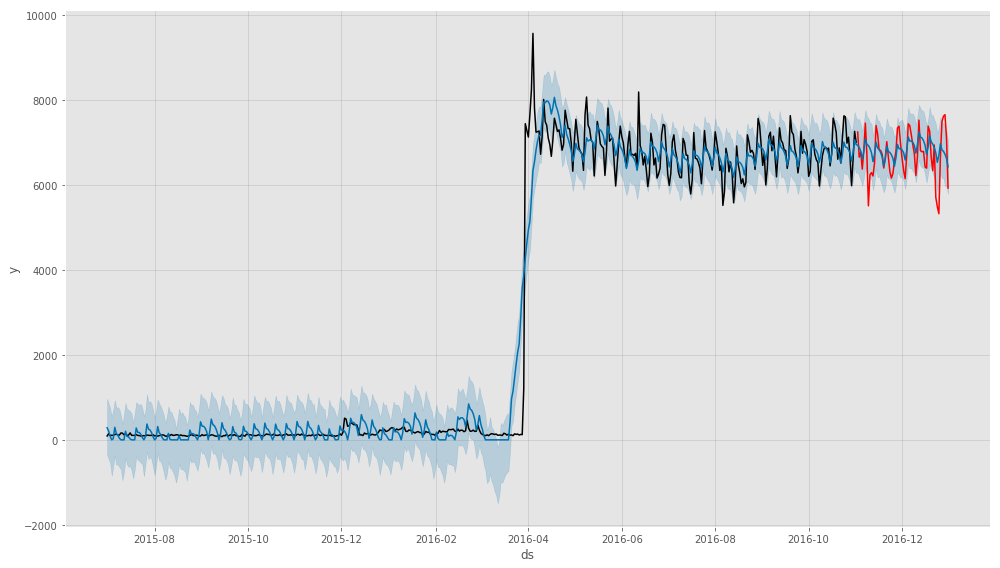

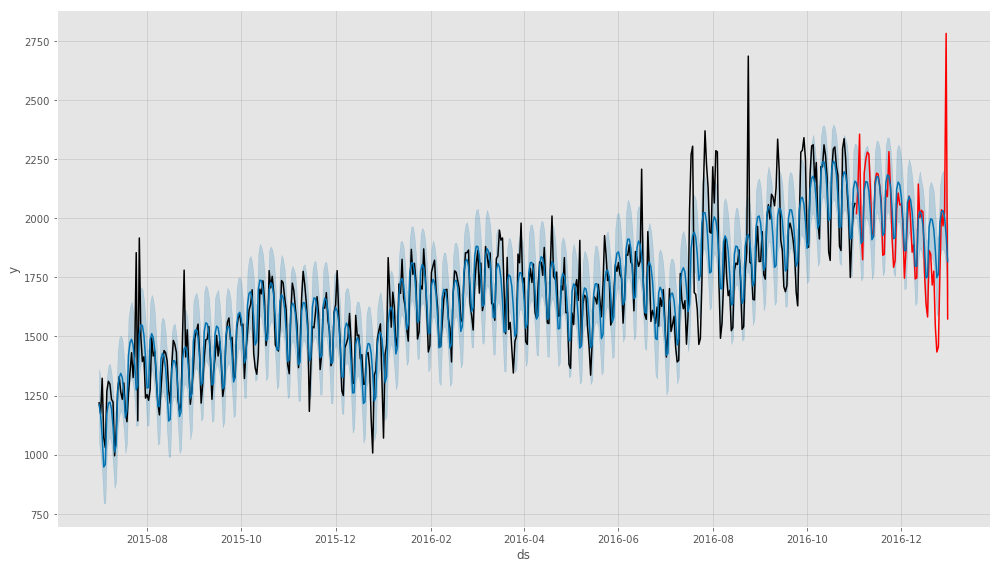

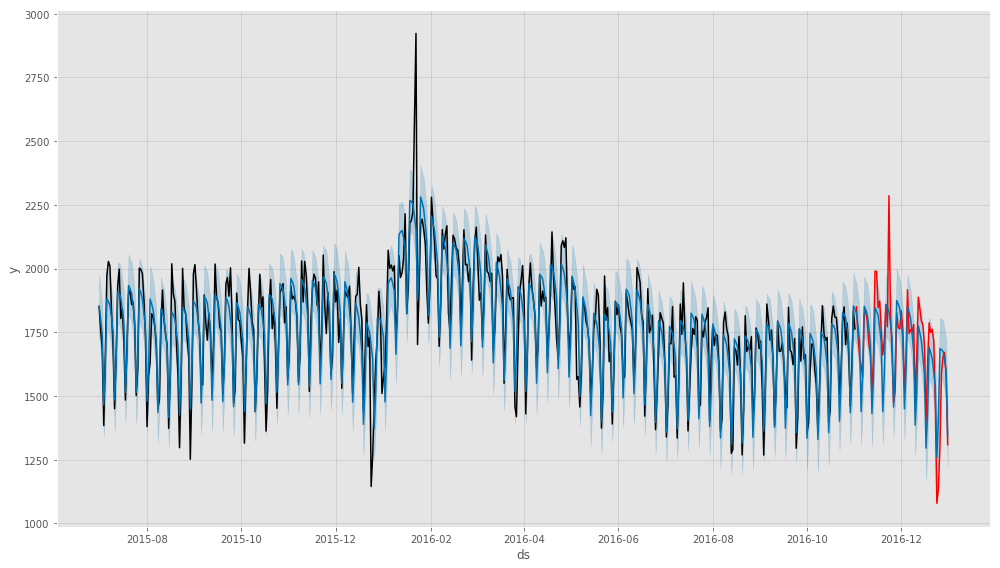

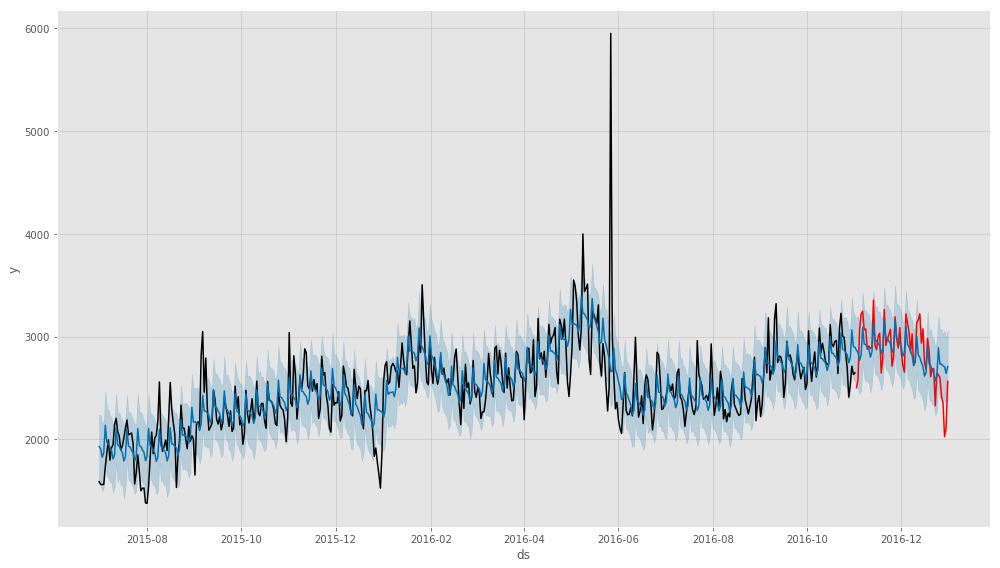

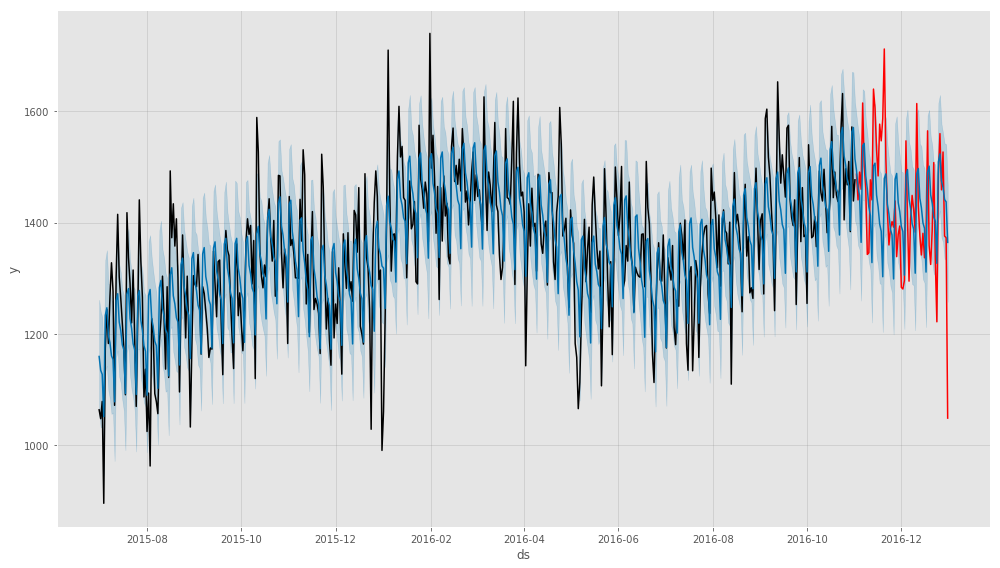

In [16]:
for row in df.sort_values(by='v1.6_val',ascending=True).iloc[:100].iterrows():
    print('page_index', row[1][0])
    print('v1.6_val', row[1][2])
    load_plot(row[1][0])

In [ ]:
130410

In [18]:
forecast130410 = pd.read_feather(PROPHET_PATH+VERSION+'130410'+'df.f')

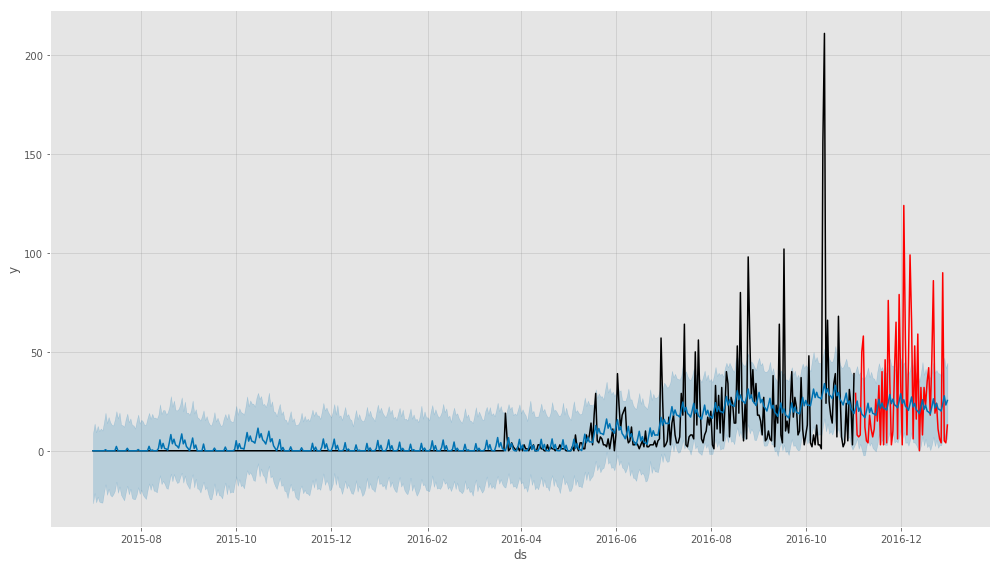

In [21]:
wiki.newphet.prophet_plot(forecast130410)

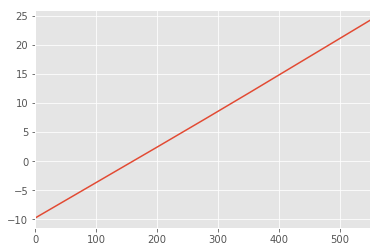

In [20]:
forecast130410.trend.plot()

In [22]:
forecast130410.trend

0      -9.765990
1      -9.705042
2      -9.644094
3      -9.583145
4      -9.522197
5      -9.461248
6      -9.400300
7      -9.339352
8      -9.278403
9      -9.217455
10     -9.156506
11     -9.095558
12     -9.034609
13     -8.973661
14     -8.912713
15     -8.851764
16     -8.790816
17     -8.729867
18     -8.668919
19     -8.607971
20     -8.547022
21     -8.486074
22     -8.425126
23     -8.364177
24     -8.303229
25     -8.242280
26     -8.181332
27     -8.120384
28     -8.059435
29     -7.998487
         ...    
520    22.437229
521    22.500273
522    22.563318
523    22.626363
524    22.689408
525    22.752453
526    22.815498
527    22.878543
528    22.941588
529    23.004633
530    23.067678
531    23.130723
532    23.193768
533    23.256813
534    23.319857
535    23.382902
536    23.445947
537    23.508992
538    23.572037
539    23.635082
540    23.698127
541    23.761172
542    23.824217
543    23.887262
544    23.950307
545    24.013352
546    24.076396
547    24.1394

In [7]:
forecast29930 = pd.read_feather(PROPHET_PATH+VERSION+'29930'+'df.f')
with open(PROPHET_PATH+VERSION+'29930'+'m.pk', 'rb') as file:
    m29930 = pk.load(file)

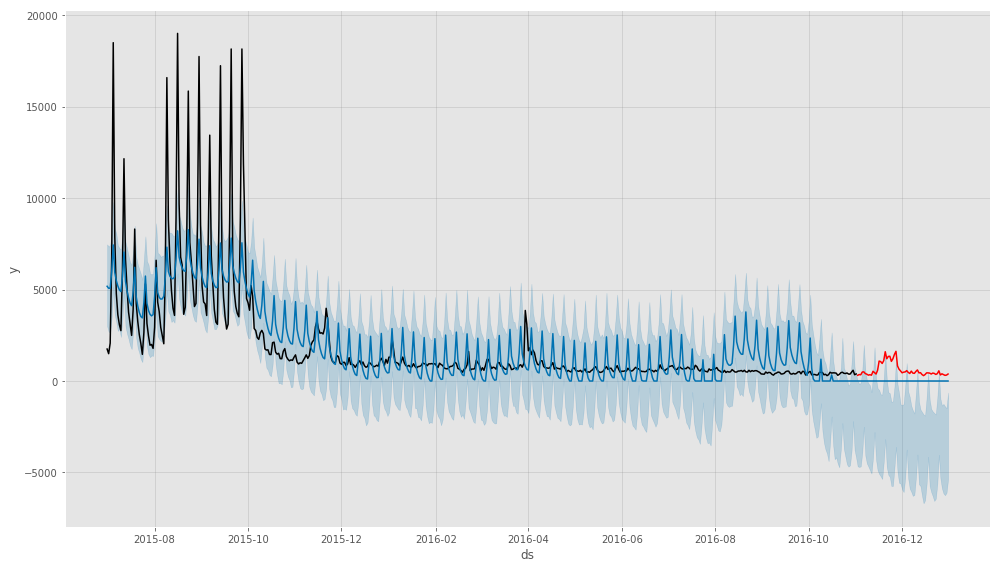

In [13]:
wiki.newphet.prophet_plot(forecast29930)

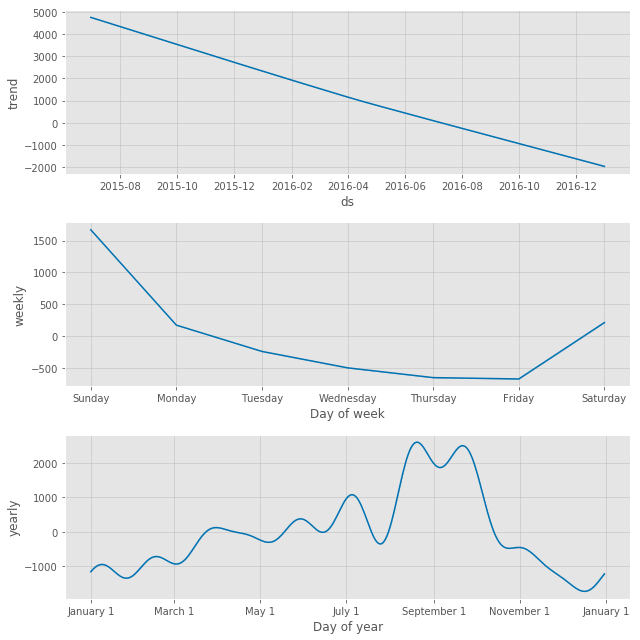

In [12]:
m29930.plot_components(forecast29930);